# Создание и тестрирование модели детекции

## Импорт необходимых библиотек

In [ ]:
# NumPy — библиотека с открытым исходным кодом для языка программирования Python. 
# Возможности:
# 1. поддержка многомерных массивов (включая матрицы);
# 2. поддержка высокоуровневых математических функций, предназначенных для работы с многомерными массивами.
# Документация: https://numpy.org/doc/stable/
import numpy as np

# pandas — программная библиотека на языке Python для обработки и анализа данных. 
# Работа pandas с данными строится поверх библиотеки NumPy, являющейся инструментом более низкого уровня. 
# Предоставляет специальные структуры данных и операции для манипулирования числовыми таблицами и временнми рядами.
# Документация: https://pandas.pydata.org/docs/
import pandas as pd 


# Matplotlib — библиотека на языке программирования Python для визуализации данных двумерной 
# (2D) графикой (3D графика также поддерживается). 
# Получаемые изображения могут быть использованы в качестве иллюстраций в публикациях. 
# Документация: https://matplotlib.org/stable/index.html
import matplotlib.pyplot as plt

# Модуль sys обеспечивает доступ к некоторым переменным и функциям, взаимодействующим с интерпретатором python.
import sys

# Модуль os предоставляет множество функций для работы с операционной системой, причём их поведение, как правило, 
# не зависит от ОС, поэтому программы остаются переносимыми.
import os

# Модуль random предоставляет функции для генерации случайных чисел, букв, случайного выбора элементов последовательности.
import random

# Модуль glob находит все пути, совпадающие с заданным шаблоном в соответствии с правилами, используемыми оболочкой Unix.
import glob

# OpenCV — это open source библиотека компьютерного зрения, которая предназначена для анализа, классификации и обработки изображений.
# Широко используется в таких языках как C, C++, Python и Java. 
import cv2

# Модуль math – один из наиважнейших в Python. Этот модуль предоставляет обширный функционал для работы с числами.
import math

# Keras — открытая библиотека, написанная на языке Python и обеспечивающая 
# взаимодействие с искусственными нейронными сетями. Она представляет собой надстройку над фреймворком TensorFlow
import keras

# Callback - это объект, который может выполнять действия на различных этапах обучения
from keras.callbacks import (
    # Callback для сохранения модели Keras или весов модели с некоторой периодичностью.
    ModelCheckpoint, 

    # Снижайет скорость обучения, когда метрика перестает улучшаться.
    ReduceLROnPlateau)

# Предупреждающие сообщения обычно выдаются в ситуациях, 
# когда полезно предупредить пользователя о некотором состоянии программы, 
# но это состояние (обычно) не требует создания исключения и завершения программы.
#  Например, можно выдать предупреждение, когда программа использует устаревший модуль.
import warnings

# Определение того, следует ли выдавать предупреждение, контролируется фильтром 
# предупреждений, который представляет собой последовательность соответствующих 
# правил и действий. Правила могут быть добавлены в фильтр вызовом filterwarnings()
# и возвращены в состояние по умолчанию вызовом resetwarnings().
# "ignore" - никогда не печатать предупреждения о warning.
warnings.filterwarnings("ignore")


Using TensorFlow backend.
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/dist-packages/tensorflow/python/framework/dtypes.py:529: FutureWarn

In [ ]:
# Для непосредственного и более удобного взаимодейтсвия с исходными данными и 
# различными реализациями в среде Colab необходимо предоставить доступ к данным 
# файлам, которые хранятся на персональном Google Диске

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Произведём копирование исходников реализации Mask R-CNN в текущую рабочую 
# среду для возможности непосредственного импорта и взаимодействия.

!cp -r /content/drive/MyDrive/Diplomnay_rabota/MaskRCNN/* ./

In [ ]:
# Произведём импорт ряда методов из реализации Mask R-CNN от Matterport Inc.

#  Utils - ряд методов направленный на работу с датасетом, исходными изображениямми 
# и вычисления метрик.
from mrcnn import utils

# Visualize - ряд методов, который предназначен для визуализации результатов 
# детекции объектов внутри изображений на различных этапах работы модели.
from mrcnn import visualize

# С помощью класса Config можно создать собственную конфигурацию для текущей
# задачи.
from mrcnn.config import Config

# Содержит ряд методов для непосредственной работой с моделью.
import mrcnn.model as orig_model

## Предобработка и подготовка данных

In [ ]:
# Произведём загрузку файла train.csv из комлпекта данных датасета, который содержит в себе информацию об аннотациях...
df = pd.read_csv(os.path.join('/content/drive/MyDrive/Diplomnay_rabota/GWHD/train.csv'))

In [ ]:
# Определим расположения исходных изображений, котоыре будут выступать 
# в качетве тестовых и валидационных датасетов

img_root = '/content/drive/MyDrive/Diplomnay_rabota/GWHD/train/'

Обратимся к решению Александра Теплюка, расположенном на сайте Kaggle (https://www.kaggle.com/code/ateplyuk/gwd-starter-efficientdet-keras-train/notebook): 
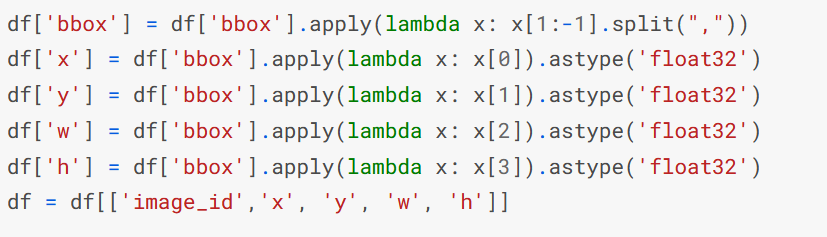 

In [ ]:
# Произведём процесс преобразования для более удобной работы с аннотационным 
# датасетом, разделив единый столбец с информацией о bounding boxes на отдельные
# стобцы, которые описывают характеристики bounding box

df['bbox'] = df['bbox'].apply(lambda x: x[1:-1].split(","))

df['x'] = df['bbox'].apply(lambda x: x[0]).astype('float32')
df['y'] = df['bbox'].apply(lambda x: x[1]).astype('float32')
df['w'] = df['bbox'].apply(lambda x: x[2]).astype('float32')
df['h'] = df['bbox'].apply(lambda x: x[3]).astype('float32')

df = df[['image_id','x', 'y', 'w', 'h']]
df.head()

,image_id,x,y,w,h
0,b6ab77fd7,834.0,222.0,56.0,36.0
1,b6ab77fd7,226.0,548.0,130.0,58.0
2,b6ab77fd7,377.0,504.0,74.0,160.0
3,b6ab77fd7,834.0,95.0,109.0,107.0
4,b6ab77fd7,26.0,144.0,124.0,117.0


Основываясь на реализации ряда методов Mask R-CNN Matterport для задач детекции номерных знаков автомобилей произведём определённую модификацию для текущей задачи.

In [ ]:
def get_picture(
    
    # Директория тренировочного датасета.
    img_dir, 
    
    # Специализированные ids для обучения или валидации.
    anns):

    # Структура данных для хранения id.
    id = []

    # Структруа данных для хранения информации об изображениях.
    picture_snaps = []

    # Добавляем информацию об id изображения.
    for index, row in anns.iterrows():
        id.append(row['image_id'])

    
    # Добавляем данные об изображении.
    for i in os.listdir(img_dir):
        if os.path.splitext(i)[0] not in id:
            continue
        else:
            picture_snaps.append(os.path.join(img_dir, i))

    # Возвращаем список данных об изображениях
    return list(set(picture_snaps))

In [ ]:
# Наработки были взяты с данного сайта (https://blog.csdn.net/LXX516/article/details/106398995)
def get_dataset(img_dir, anns): 

    # Определяем данные об изображении на основе предыдущего метода.
    image_snaps = get_picture(img_dir, anns)

    # Определяем данные об аннотациях для изображения
    image_info = {snap: [] for snap in image_snaps}

    for index, row in anns.iterrows(): 

        # Подготавливаем датасет
        snap = os.path.join(img_dir, row['image_id'] + '.jpg')

        # Добавляем итоговую информацию
        image_info[snap].append(row)

    return image_snaps, image_info

## Создание генератора данных для модели Mask R-CNN

Основываясь на классе Dataset из файла utils.py Matterport составим класс, который бы отвечал за исходные датасеты.

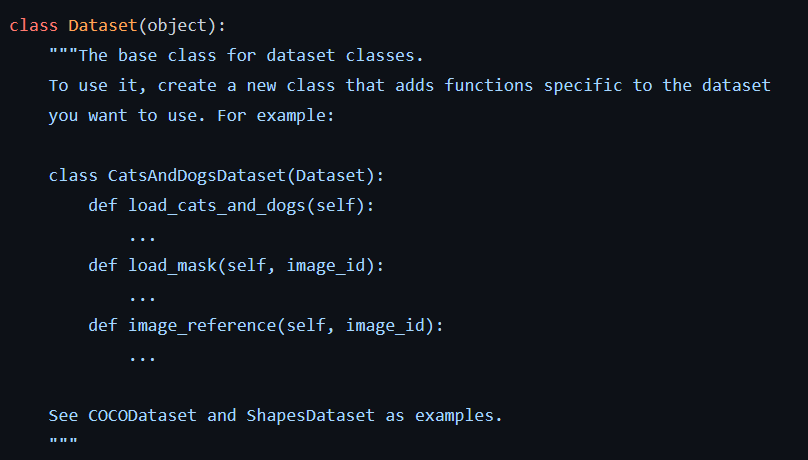

Для загрузки маски использовались наработки из работы по детекции кораблей на море (https://spell.ml/blog/ship-detection-in-satellite-images-using-mask-r-cnn-XyMA4xEAACUAb9G1):
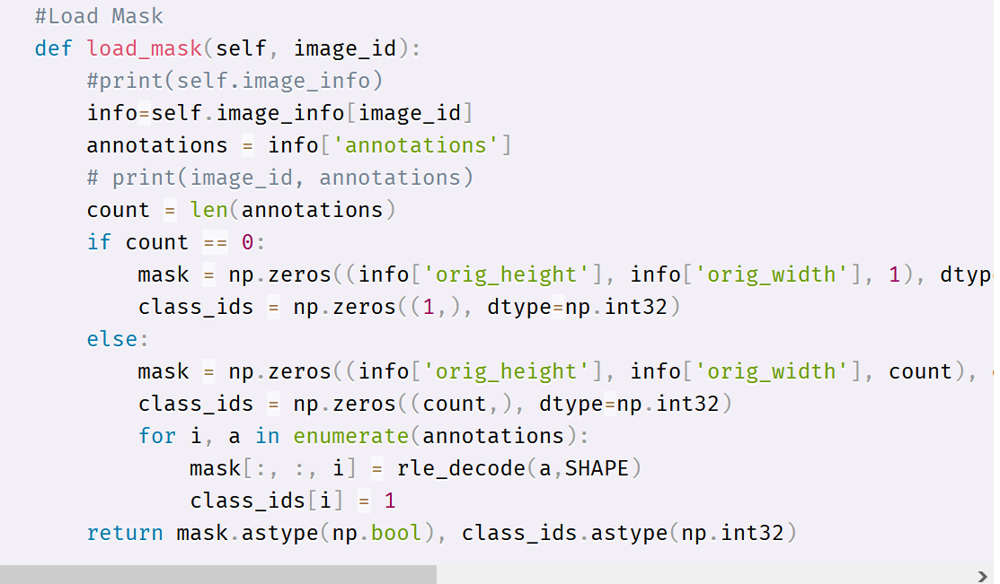

Для последующей работы с bounding boxes были взяты наработки из MD.ai документации (https://docs.md.ai/libraries/python/guides-convert-json/)
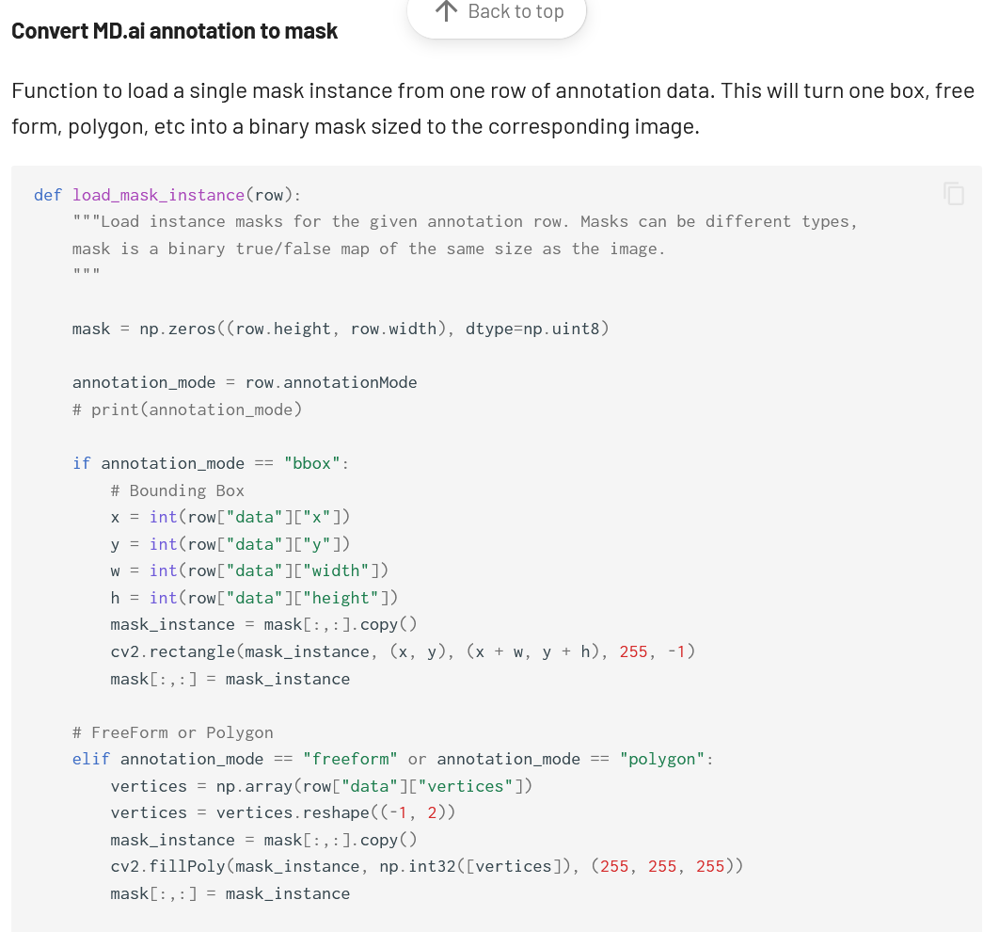

In [ ]:
# Согласно рекомендациям назовём собственный класс Detector Dataset.

class DetectorDataset(utils.Dataset): # В качестве параметра будет передаваться
# исходная раелизация 
                            
    def __init__(self, image_snaps, image_info, orig_height, orig_width):
        super().__init__(self)
        
        # def add_class отвечает за добавление класса в формате:
        # source (источник класса), class_id (идентификационный номер класса),
        # class_name (название класса)
        self.add_class('ПшеницаДиплом', 1 , 'Пшеница') # в текущей задачи фигурирует
        # лишь 1 класс - Пшеница
        
        
        for id, snap in enumerate(image_snaps):
            annotations = image_info[snap]
            # def add_image отвечает за добавление изображений в формате: 
            # source (источник изображения), image_id(идентификационный номер 
            # изображения), path (расположения изрбражения), **kwargs (что 
            # означает возможность передачи произвольного количества аргументов.
            # В данном случае будет производиться работа с аннотациями и размерами
            # изображения):  
            self.add_image('ПшеницаДиплом', image_id=id, 
                           path=snap, annotations = image_info[snap], 
                           orig_height=orig_height, orig_width=orig_width)

    # Согласно документации def load_mask предназначен для загрузки маски  
    # для данного изображения. Различные наборы данных используют разные способы 
    # хранения масок. Необходимо переопределить этот метод для загрузки масок 
    # экземпляров и возврата их в виде массива бинарных масок формата 
    # [height, width, instances].
    # В качестве выходных данных предоставляет:
    #    masks: массив bool формата [height, width, instance count] с
    #           двоичной маской для каждого экземпляра.
    #    class_ids: одномерный массив идентификаторов классов масок экземпляров.



    # Наработки для данного метода также были взяты с соревнования по детекции
    # деффектов стали с Kaggle
    # (https://www.kaggle.com/competitions/severstal-steel-defect-detection/code).
    def load_mask(self, image_id):

        # Определяем информацию об аннотациях
        info = self.image_info[image_id]

        # Проверяем наличие аннотаций.
        if len(info['annotations']) == 0:
            
            # В качестве первоначальной маски возвращаем новый массив заданной формы 
            # и типа, заполненный нулями.
            mask = np.zeros((info['orig_height'], info['orig_width'], 1), 
                            dtype = np.uint8)
            
            # Так же делаем и с class_ids.
            class_ids = np.zeros((1,), dtype=np.int32)
        else:

            # В противном случае создаётся маска иной формы.
            mask = np.zeros((info['orig_height'], info['orig_width'], len(info['annotations'])),
                            dtype = np.uint8)
            
            # То же происходит и с class_ids.  
            class_ids = np.zeros((len(info['annotations']),), dtype=np.int32)

            # Наработки для данной части взяты из данной работы:
            # https://github.com/mdai/mdai-client-py/blob/master/mdai/visualize.py
            for i, a in enumerate(info['annotations']):
                x = int(a['x'])
                y = int(a['y'])
                w = int(a['w'])
                h = int(a['h'])

                # Происходит определение маски.
                # (https://github.com/CornellDataScience/PneumoniaDetection/blob/master/data_manipulation.py)
                mask_instance = mask[:, :, i].copy()

                # (https://ebookreading.net/view/book/EB9781789531619_68.html)
                cv2.rectangle(mask_instance, (x, y), (x + w, y + h), 255, -1)

              
                # (https://mdai.github.io/mdai-client-py/_modules/mdai/visualize.html)
                mask[:, :, i] = mask_instance

              
                class_ids[i] = 1

        # Возвращает маску и массив идентификаторов классов каждого экземпляра. 
        return mask.astype(np.bool), class_ids.astype(np.int32)
    
    # def load_image загружает указанное изображение и возвращает массив
    # Numpy [H,W,3].
    def load_image(self, image_id):

        #
        info = self.image_info[image_id]
        #
        image = cv2.imread(info['path'], cv2.IMREAD_COLOR)

        # If grayscale. Convert to RGB for consistency.
        if len(image.shape) != 3 or image.shape[2] != 3:
            image = np.stack((image,) * 3, -1)
        return image
    
    # def image_reference возвращает ссылку на изображение в его источнике
    # в Интернете или подробную информацию о
    # изображении, которая поможет найти его или проивзести некоторые работы.
    # Необходимо переопределить для текущего набора данных
    def image_reference(self, image_id):
      
        info = self.image_info[image_id]

        return info['path']

## Разделение датасетов на train и val датасеты

In [ ]:
# О непосредственном приницпе, по которому разделяются датасеты можно узнать 
# в основном тексте дипломный работы

image_ids = df['image_id'].unique()

# Определяем размер train датасет
train_ids = image_ids[:-600]

# Определяем val датасет
valid_ids = image_ids[-600:]

# Проверяем содержит ли каждый элемент в DataFrame значения.
train_df = df[df['image_id'].isin(train_ids)]

# Аналогичные действия для val датасета. 
valid_df = df[df['image_id'].isin(valid_ids)]

## Создание Train датасета

In [ ]:
# Используем ранее определённый метод get_dataset для создания соответстующего train датасета, объединив 
# изображения и соответствующие аннотации.

train_image_snaps, train_image_info = get_dataset(img_root,
                                                       anns = train_df)

# Создам генератор данных, используя ранее определённый класс. 
dataset_train = DetectorDataset(train_image_snaps, 
                                train_image_info,
                                1024, 
                                1024)

## Создание val датасета

In [ ]:
# Произведём аналогичные действия
valid_image_snaps, valid_image_info = get_dataset(img_root, 
                                           anns=valid_df)

dataset_valid = DetectorDataset(valid_image_snaps, valid_image_info,
                                1024, 1024)


Согласно исходной реализации произведём подготовку датасетов

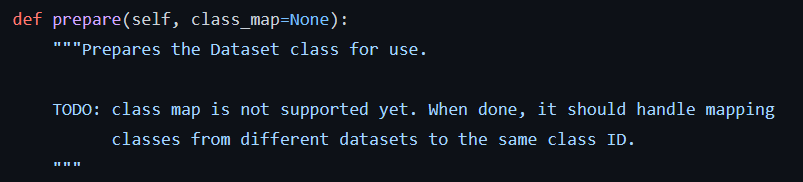

In [ ]:
dataset_train.prepare()
dataset_valid.prepare()

## Аугментация
О концепции аугментации, подходам к её реализации и используемую библиотеку для достижения поставленной цели монжо отдельно почитать в основном тексте дипломной работы

In [ ]:
# Установим зависимости для работы с ImgAug библиотекой
!pip install /content/drive/MyDrive/Diplomnay_rabota/ImgAug/imgaug-0.4.0-py2.py3-none-any.whl -q

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.4.0 which is incompatible.


In [ ]:
# Импортируем ряд аугментаторов
from imgaug import augmenters as iaa

# Определяем кастомную аугментацию.
# Этот аугментатор представляет собой просто список других аугментаторов.
# Чтобы дополнить изображение или любые другие данные, он перебирает свои дочерние элементы и 
# применяет каждый из них независимо к данным. (Это также означает, что второй примененный аугментатор
# будет получать уже дополненные входные данные и дополнять их дальше).
augmentation = iaa.Sequential([
    
    # Что тут делаем
        iaa.OneOf([
            
            # Последовательно определяем вращение изрбражения в градусах.
            iaa.Affine(rotate=0),
            
            # Каждый раз увеличиваем данный показатель на 90 градусов.
            iaa.Affine(rotate=90),
            
            iaa.Affine(rotate=180),
            
            iaa.Affine(rotate=270),
            
        ]),
    
        # Переворачивание/зеркальное отображение входных изображений по горизонтали c определённой вероятностью
        # произведения переворачивания.
        iaa.Fliplr(0.6),
    
        # Переворачивание/зеркальное отображение входных изображений по горизонтали также с вероятностью.
        iaa.Flipud(0.3),
    
        # OneOf: дополняющий модуль, который всегда выполняет только один из своих дочерних модулей.
        iaa.OneOf([ 
            
            # Заполнение одной области в изображении с использованием режима заливки (in-place).
            # Этот метод вырезания использует координаты верхнего левого и нижнего правого углов вырезаемой
            # области, заданные как абсолютные значения пикселей.
            # В данном случае для каждого изображения заполняется от одной до пяти областей, каждая из которых 
            # имеет 20% от соответствующего размера высоты и ширины (для неквадратных изображений это приводит 
            # к заполнению неквадратных областей).
            iaa.Cutout(fill_mode = "constant", cval = 255),
            
            # Установление значений прямоугольных областей внутри изображения на ноль.
            # В отличие от Dropout, эти области могут иметь большие размеры. 
            # Этот метод реализуется путем создания маски обнуления с меньшим разрешением 
            # (чем имеет изображение), а затем повышением дискретизации маски перед обнулением пикселей.
            # Этот аугментатор похож на Cutout. Обычно вырезание определяется как операция, которая удаляет
            # из изображения ровно один прямоугольник, в то время как CoarseDropout может удалять 
            # несколько прямоугольников (с некоторой корреляцией между размерами этих прямоугольников).
            iaa.CoarseDropout(
                              # Вероятность обнуления каждого пикселя
                              (0.0, 0.05), 
                              
                              # Размер изображения с более низким разрешением, из которого следует делать
                              # выборку маски обнуления, в процентах от входного изображения. 
                              # Обратите внимание, что меньшие значения этого параметра приводят к 
                              # обнулению больших областей (поскольку любой пиксель в изображении с 
                              # меньшим разрешением будет соответствовать большей области в исходном 
                              # разрешении).
                              size_percent = (0.02, 0.25)),
            ]),
        
        iaa.OneOf([ ## weather augmentation
            # Добавляет на изображения один слой, состоящий из падающих снежинок. Обёртка вокруг RainLayer.
            iaa.Snowflakes(
                
                # Размер снежинок. Этот параметр контролирует разрешение, с которым производится выборка 
                # снежинок. Более высокие значения означают, что разрешение приближено к разрешению 
                # входного изображения, и, следовательно, каждая снежинка будет меньше (из-за меньшего 
                # размера пикселя).
                flake_size=(0.2, 0.4), 
                
                # Воспринимаемая скорость падения снежинок. Этот параметр управляет размером ядра размытия 
                # движения. Он имеет примерно такую форму: kernel_size = image_size * speed. Следовательно, 
                # значения около 1.0 означают, что размытие движения должно "растянуть" каждую снежинку на 
                # всё изображение.
                speed=(0.03, 0.06)),
            
            # Добавляет на изображения один слой падающих капель дождя.
            iaa.Rain(speed=(0.2, 0.6)),
        ]),  
        
    
        iaa.OneOf([ 
            
            # Умножает все пиксели изображения на случайное значение, выбираемое один раз для каждого 
            # изображения. Этот аугментатор можно использовать, чтобы сделать изображение светлее или темнее.
            iaa.Multiply((0.7, 1.0)),
            
            # Настраивает контрастность путем масштабирования каждого пикселя на 127 + alpha * (v - 127).
            iaa.contrast.LinearContrast((0.8, 1.3)),
        ]),
        
        iaa.OneOf([
            
            # Дополнение для размытия изображений с помощью гауссовых ядер.
            # sigma: Стандартное отклонение гауссова ядра. Обычно используются значения в диапазоне от 0.0 
            # (отсутствие размытия) до 3.0 (сильное размытие).
            iaa.GaussianBlur(sigma=(0.0, 0.1)),
            
            # Усилитель резкости, повышающий резкость изображений и накладывающий результат на исходное 
            # изображение. 
            # alpha: Коэффициент смешивания изображения с резкостью. При значении 0.0 видно только 
            # исходное изображение, при значении 1.0 - только его версия с эффектом резкости.
            iaa.Sharpen(alpha=(0.0, 0.1)),
        ])
    ],
    
    # Sequential аугментатор предлагает возможность применять свои дочерние элементы в случайном порядке с 
    # помощью параметра random_order. Этот параметр следует часто активировать, так как он значительно 
    # увеличивает пространство возможных дополнений
    random_order=True
)

Согласно официльной реализации Mask R-CNN Matterport для задач детекции людей и военной техники в аэропорту Rammstein используем следующий метод.

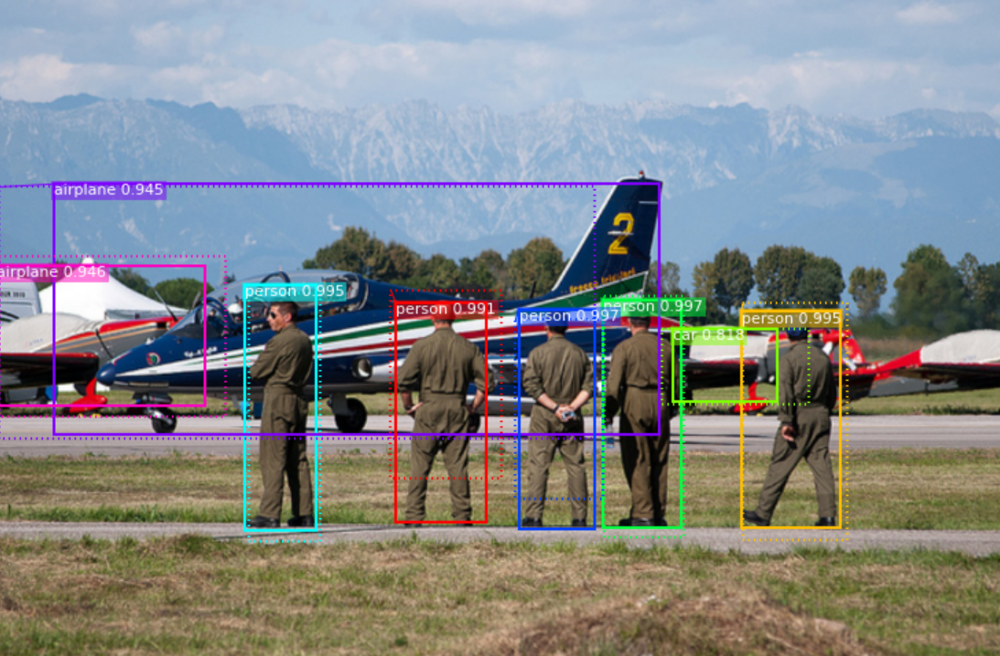

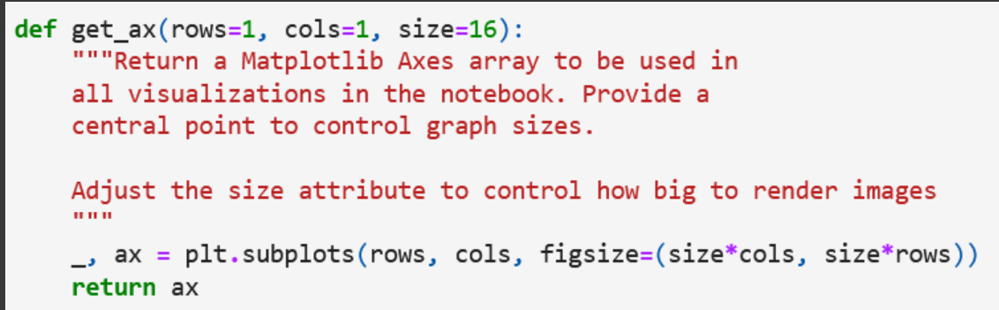

In [ ]:
def get_ax(rows = 1, cols = 1, size = 5):
    _, ax = plt.subplots(rows, cols, figsize = (size * cols, size * rows))
    return ax

А также согласно реалиазции Mask R-CNN Matterport для обнаружения аномалий 
на рентгеновских снимках грудной клетки используем следующий модифицированный 
метод:

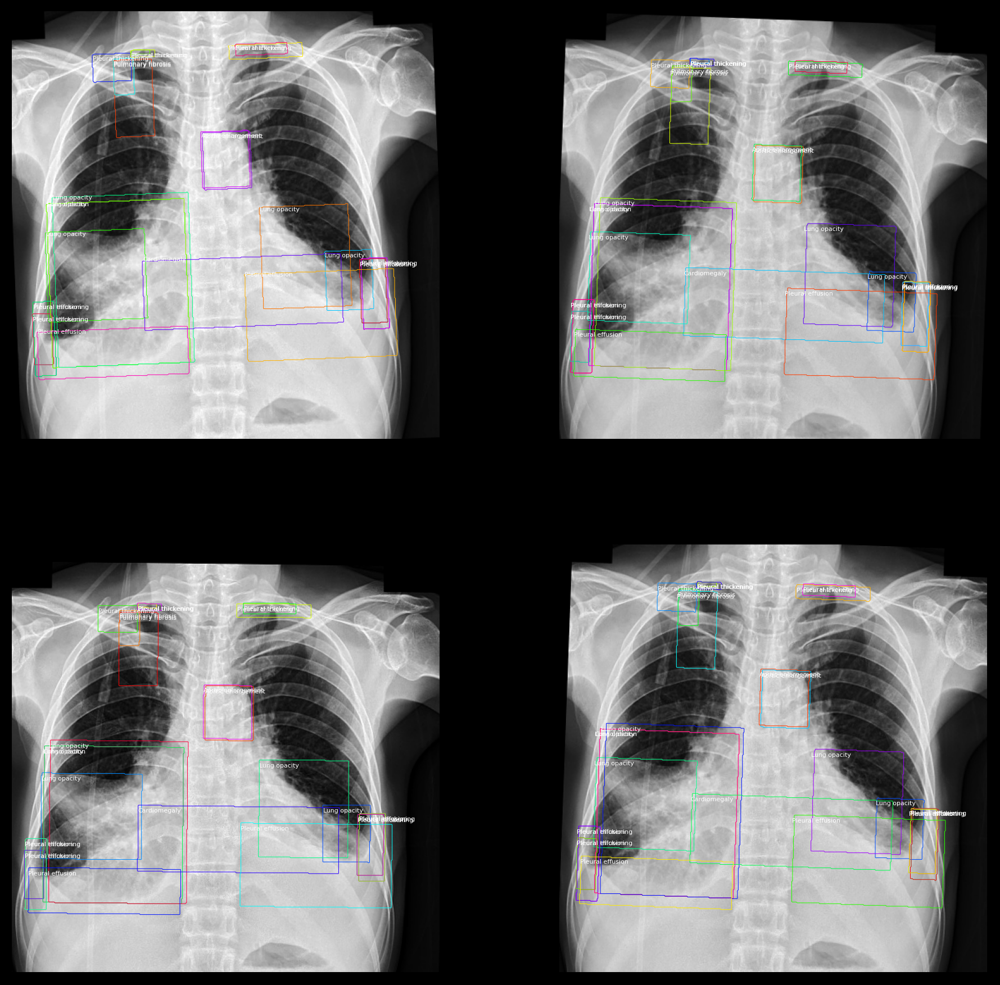

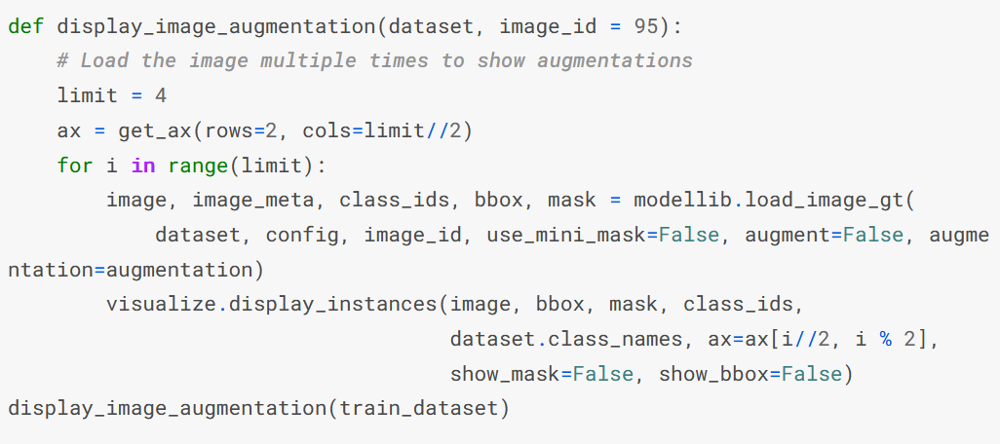

Также используем метод load_image_gt из официально реализации для вывода информации об истинном расположении объекта.

Был использован ряд наработок с данного сайта: https://www.programcreek.com/python/example/116628/utils.resize_mask

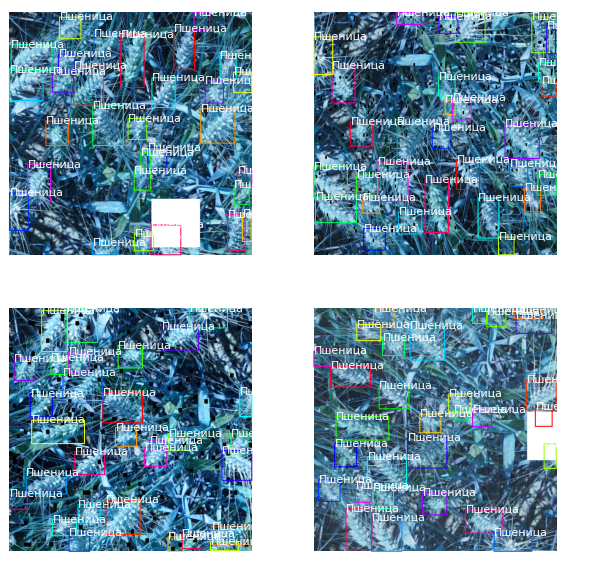

In [ ]:
image_id = np.random.choice(dataset_train.image_ids, 1)[0]
image = dataset_train.load_image(image_id)

# Определяем ax согласно лимиту из документации.
ax = get_ax(rows = 2, cols = 4//2)

# В размере limit.
# image - # Изображение в формате [height, width, 3].
# shape: # Оригинальный размер изображения перед преобразованиями
# class_ids: # [instance_count] IDs классов. 
# bbos: # Данные о bboxes в формате [instance count, (y1, x1, y2, x2)]
# mask: # [height, width, instance count]. Высота и ширина такие же как у изображение, 
# кроме тех случаев, когда use_mini_mask = True. 
for i in range(4):
    image, image_meta, class_ids,\
    bbox, mask = orig_model.load_image_gt(
        
        # Тренировочный датасет.
        dataset_train, 

        # Ранее определённый config. 
        config, 

        # Id изображения.
        image_id, 

        #Если False, возвращает полноразмерные маски, которые имеют ту же высоту
        # и ширину как у исходного изображения. Они могут быть большими, например
        # 1024x1024x100 (для 100 экземпляров). Мини-маски меньшего размера, обычно,
        # 224x224 и генерируются путем извлечения ограничивающей рамки объекта
        # и изменения его размера до MINI_MASK_SHAPE.
        use_mini_mask = False,

        # deprecated (не рекомендуется к использованию).
        # Необходимо использовать аугментацию вместо этого.
        # Если true, применяется случайная аугментация изображения.
        # Сейчас доступно только горизонтальное переворачивание.
        augment = False, 

        # Опционально. Рекомендуется imgaug (https://github.com/aleju/imgaug) аугментация.
        # Передаём ранее определённую аугментацию.
        augmentation = augmentation)
    
    # Выведем изображения согласно методу из реализации.
    visualize.display_instances(
        # Исходное изображение.
        image, 

        # [num_instance, (y1, x1, y2, x2, class_id)] в рамках координат.
        bbox, 

        # [height, width, num_instances]
        mask, 

        # [num_instances]
        class_ids,

        # Список названий классов. 
        dataset_train.class_names, 

        # Используем ранее определённый метод для визуализации.
        ax = ax[i//2, i % 2],

        # Показывать маску или bounding boxes или нет. 
        show_mask=False, 
        show_bbox=False)

## Конфигурация модели

Перед конфигурацией модели изучил ряд публикаций с рекомендациями по использованию Mask R-CNN с целью увеличения показателей производительности и эффективности. 
Вот одно из них (https://github.com/matterport/Mask_RCNN/issues/527):
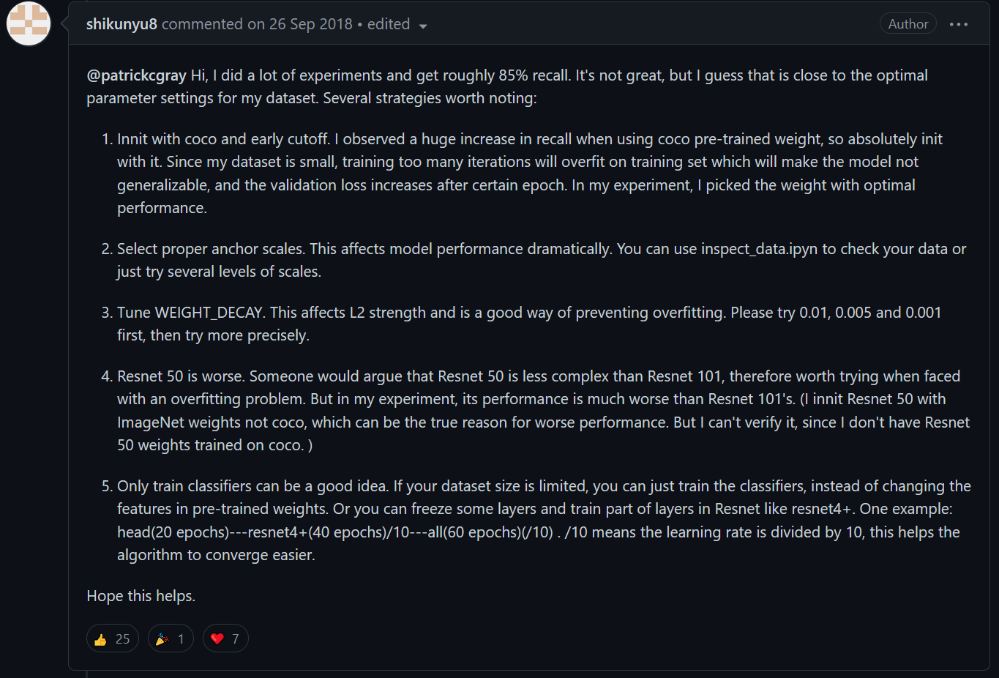

Согласно исходному классу реализации Mask R-CNN Matterport создадим собственную конфигурацию для текущей задачи

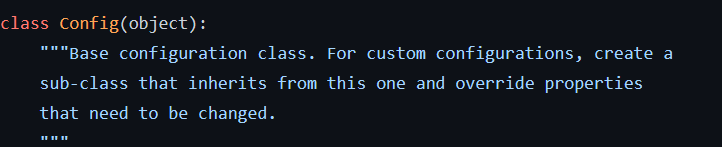

In [ ]:
class OwnConfig(Config):

    # Присвоим config определённое имя
    NAME = 'Diplom_wheat_config'

    # Число используемых графических процессоров. 
    # При использовании только CPU это значение должно быть равно 1.
    # GPU - Графический процессор — отдельное устройство персонального компьютера или игровой приставки, 
    # выполняющее графический рендеринг
    # CPU - Центральный процессор (CPU) — электронный блок либо интегральная схема, исполняющая машинные инструкции (код программ),
    # главная часть аппаратного обеспечения компьютера или программируемого логического контроллера. 
    # В нашем случае из-за отсутствия специализрованной видеокарты (Geforce RTX 3090 и т.д.), GPU использоваться 
    # не будет, поэтому определяем это значение в качестве 1. 
    GPU_COUNT = 1

    # Number of images to train with on each GPU. A 12GB GPU can typically
    # handle 2 images of 1024x1024px.
    # Adjust based on your GPU memory and image sizes. Use the highest
    # number that your GPU can handle for best performance.
    # Кол-во изображений для тренировки на каждом GPU. 12 GB GPU обычно может 
    # справится с 2 изображениями 1024x1024.
    
    IMAGES_PER_GPU = 1

    # Количество шагов обучения за эпоху.
    # Tensorboard обновления сохраняются в конце каждой эпохи, поэтому установка этого значения на
    # меньшее число означает более частое обновление TensorBoard.
    # Статистика валидации также вычисляется в конце каждой эпохи, и она
    # может занять некоторое время, поэтому нет необходимости устанавливать это значение слишком маленьким, 
    # чтобы не тратить много времени на статистику валидации.

    # https://www.reddit.com/r/deeplearning/comments/nwt13h/fix_class_imbalance_in_mask_r_cnn/
    STEPS_PER_EPOCH = 120

    # Количество шагов валидации, выполняемых в конце каждой эпохи обучения.
    # Большее число повышает точность статистики валидации, но замедляет обучение.

    # https://github.com/matterport/Mask_RCNN/issues/281
    VALIDATION_STEPS = 60

    # Backbone сеть архитекутры
    # Поддерживается: resnet50, resnet101.
    # См. основной текст диплома
    BACKBONE = "resnet101"

    # Нужен только в случае использования вызываемого backbone.
    COMPUTE_BACKBONE_SHAPE = None

    # Strides каждого слоя FPN пирамиды. Эти значения основаны
    # на ResNet101 backbone.
    BACKBONE_STRIDES = [4, 8, 16, 32, 64]

    # Размер полносвязных слоёв в классификационном графе.
    FPN_CLASSIF_FC_LAYERS_SIZE = 1024

    # Размер top-down слоёв, которые используются для построения свойств пирамиды.
    TOP_DOWN_PYRAMID_SIZE = 256

    # Количество исследуемых классов (+ 1 для backgorund класса)
    NUM_CLASSES = 2

    # Длина стороны квадратного anchor в пикселях.
    # Используются anchors различного размера из-за того что объекты multi-scale 
    # (некоторые слишком большие, а некоторые - маленькие)

    # https://github.com/matterport/Mask_RCNN/issues/610
    RPN_ANCHOR_SCALES = (16, 32, 64, 128, 256)

    # Соотношение anchors в каждой ячейке (ширина/высота)
    # Значение 1 представляет квадратный anchor, а 0,5 - широкий anchor.
    RPN_ANCHOR_RATIOS = [0.5, 1, 2]

    # Anchor stride
    # Если 1, то anchors создаются для каждой ячейки в карте характеристик backbone.
    # Если 2, то anchors создаются для каждой другой ячейки, и так далее.
    RPN_ANCHOR_STRIDE = 1

    # Non-max suppression threshold для фильтрации RPN областей.
    # Можно повысить значение во время обучения для генерации большего кол-ва
    # областей.
    RPN_NMS_THRESHOLD = 0.7

    # Кол-во anchors на изображение для обучения RPN.
    RPN_TRAIN_ANCHORS_PER_IMAGE = 256
    
    # Кол-во ROIs после tf.nn.top_k и перед non-maximum suppression
    PRE_NMS_LIMIT = 6000

    # ROIS после non-maximum suppression (для training and inference)
    POST_NMS_ROIS_TRAINING = 2000
    POST_NMS_ROIS_INFERENCE = 1000

    # Если True, то изменяет размер маски в меньшую сторону для уменьшения 
    # употребления памяти. Рекомендуется во время работы с изображениями 
    # высокого разрешенияю
    USE_MINI_MASK = True

    # (height, width) мини-маски
    MINI_MASK_SHAPE = (56, 56)  
    
    # Изменение размера входного изображения
    # Как правило, для обучения и прогнозирования используется режим изменения размера "square".
    # и он должен работать хорошо в большинстве случаев. В этом режиме изображения масштабируются
    # так, чтобы маленькая сторона была = IMAGE_MIN_DIM, но при этом обеспечивается, что
    # масштабирование не делало длинную сторону > IMAGE_MAX_DIM. Затем изображение
    # заполняется нулями, чтобы сделать его квадратным, чтобы можно было поместить несколько изображений
    # в одну batch.
    # Доступные режимы изменения размера:
    # none:   Не изменять размер и не добавлять нули. Возвращает изображение без изменений.
    # square: Изменить размер и заполнить нулями, чтобы получить квадратное изображение
    # размера [max_dim, max_dim].
    # pad64:  Складывает ширину и высоту с нулями, чтобы сделать их кратными 64.
    # Если IMAGE_MIN_DIM или IMAGE_MIN_SCALE не None, то выполняется масштабирование.
    # увеличивается перед добавлением. IMAGE_MAX_DIM в этом режиме игнорируется.
    # Кратное 64 число необходимо для обеспечения плавного масштабирования характеристик
    # карты вверх и вниз по 6 уровням пирамиды FPN (2**6=64).
    # crop:   Выбирает случайные кадры из изображения. Сначала масштабирует изображение на основе
    # на основе IMAGE_MIN_DIM и IMAGE_MIN_SCALE, затем выбирает случайный кадр размером
    # IMAGE_MIN_DIM x IMAGE_MIN_DIM. Может использоваться только при обучении.
    # IMAGE_MAX_DIM в этом режиме не используется.
    IMAGE_RESIZE_MODE = "square"

    # Уже известно, что все изображения имеют единый формат: 1024x1024
    IMAGE_MIN_DIM = 1024
    IMAGE_MAX_DIM = 1024

    # Минимальный коэффициент масштабирования. Проверяется после MIN_IMAGE_DIM 
    # и может продолжить дальнейшее величение масштаба. Например, если установлено
    # значение 2, то изображения будут масштабироваться до удвоенного значения
    # ширины и высоты или больше, даже если MIN_IMAGE_DIM этого не требует.
    # Однако в "square" режиме это значение может быть перезаписано IMAGE_MAX_DIM.
    IMAGE_MIN_SCALE = 0

    # Количество цветовых каналов в изображении. RGB = 3, grayscale = 1, RGB-D = 4
    # Изменение этого параметра требует других изменений в коде. Подробнее см. в WIKI.
    # подробности: https://github.com/matterport/Mask_RCNN/wiki
    IMAGE_CHANNEL_COUNT = 3

    # Среднее значение изображения (RGB)
    MEAN_PIXEL = np.array([123.7, 116.8, 103.9])

    # Количество ROI на изображение для подачи в классификатор
    # В документе Mask R-CNN используется 512, но часто RPN не генерирует
    # достаточное кол-во положительных предложений, чтобы заполнить это число и сохранить 
    # соотношение положительных и отрицательных предложений используется соотношение 1:3. 

    # https://russianblogs.com/article/4946292309/
    TRAIN_ROIS_PER_IMAGE = 350

    # Процент положительных ROIs, используемых для обучения классификатора/маски головки

    # https://gilberttanner.com/blog/getting-started-with-mask-rcnn-in-keras
    ROI_POSITIVE_RATIO = 0.33

    # Объединенные ROIs
    POOL_SIZE = 7
    MASK_POOL_SIZE = 14

    # Форма выходной маски.
    # Чтобы изменить это значение, необходимо также изменить ветвь маски нейронной сети.
    MASK_SHAPE = [28, 28]

    # Максимальное количествово истинных объектов, которые могут быть определеныы на 1 изображении

    # https://github.com/matterport/Mask_RCNN/issues/1071
    MAX_GT_INSTANCES = 500 
    

    # Стандартное отклонение уточнения bounding box для RPN и окончательных обнаружений.
    RPN_BBOX_STD_DEV = np.array([0.1, 0.1, 0.2, 0.2])
    BBOX_STD_DEV = np.array([0.1, 0.1, 0.2, 0.2])

    # Максимальнок кол-во финальных обнаружений

    # https://github.com/matterport/Mask_RCNN/issues/1884
    DETECTION_MAX_INSTANCES = 100

    # Минимальное значение вероятности для принятия обнаруженного экземпляра
    # ROIs ниже этого порога пропускаются

    # https://habr.com/ru/post/483018/
    DETECTION_MIN_CONFIDENCE = 0.60

    # Максимальный порог подавления для обнаружения

    # https://colab.research.google.com/github/TannerGilbert/MaskRCNN-Object-Detection-and-Segmentation/blob/master/MaskRCNN%20Using%20pretrained%20model.ipynb
    DETECTION_NMS_THRESHOLD = 0.3

    # Learning rate
    # Согласно официальной документации Mask RCNN используется lr=0.02, но в случае работы с TensorFlow это приводит
    # к тому весовые коэффициенты показывают аномальные значения. Вероятно, это связано с различиями в оптимизаторе
    # реализации.
    # Немного увеличим данное значение.

    # Данное значение выбрано, основываясь на рекомендации представленной в 
    # этой статье: https://arxiv.org/pdf/2008.00460.pdf
    LEARNING_RATE = 0.005

    # https://github.com/OrdnanceSurvey/Mask_RCNN-for-Caravans/blob/master/samples/coco/inspect_model.ipynb   
    LEARNING_MOMENTUM = 0.9

    # Регуляризация с уменьшением веса
    # L_2-регуляризация (также называемая сокращением весов, англ. weight decay), 
    # которая использует более прямой подход к регуляризации, необходима для контроля переобучения.

    # https://colab.research.google.com/github/satyajeetmaharana/HandDetection_MaskRCNN/blob/master/Mask%20R%20CNN%20Model%20for%20Hand%20Detection_Notebook.ipynb
    WEIGHT_DECAY  = 0.0005

    # Веса потерь для более точной оптимизации.
    # Может использоваться для настройки обучения R-CNN.

    # https://github.com/matterport/Mask_RCNN/issues/846
    LOSS_WEIGHTS = {
        "rpn_class_loss": 1.,
        "rpn_bbox_loss": 1.,
        "mrcnn_class_loss": 1.,
        "mrcnn_bbox_loss": 1.,
        "mrcnn_mask_loss": 1.
    }

In [ ]:
# Определим и выведем Config.
config = OwnConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.6
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  1024
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.005
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE        

## Настройка модели

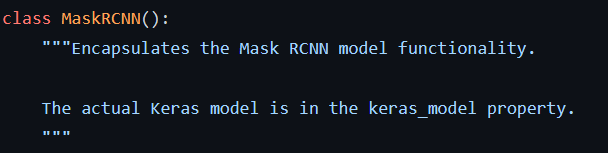

In [ ]:
# Создадим функционал для определения модели.
def model_creating():
    
    # В исходниках содержится класс Mask R-CNN, который служит для непосредственного определния 
    # функицональности модели. 
    model = orig_model.MaskRCNN(
                              # Определяем режим, в котором будет производиться работа. 
                              # Существует 2 варианта: training (обучение) и inference (вывод). 
                              mode = 'training',

                              # Далее определяем config модели.
                              config = config, 

                              # А также путь по которому будет сохранены логи обучения и обученные веса.
                              model_dir = '/content/drive/MyDrive/Diplomnay_rabota/Model')
    
    # Как уже было описано в основном тексте диплом в данной работе будут использоваться предобученные на COCO веса, 
    # которые можно обнаружить на официальном ресурсе: ... 
    # Веса находятся в формате .h5, который используется для хранения данных о модели при работе с Keras.
    
    # model.load_weights - модифицированная версия соответствующей функции Keras с добавлением поддержки 
    # нескольких графических процессоров и возможностью исключить некоторые слои из загрузки.
    # exclude: список имен слоев для исключения
    model.load_weights('/content/drive/MyDrive/Diplomnay_rabota/COCO_weights/mask_rcnn_coco.h5',
    
                       # Включаем режим исключения по имени.
                       by_name = True, 

                       # С целью избежания проблемы несоответствия количества 
                       # классов, которая может возникнуть в случае 
                       # загрухки весов модели, которые были обучены на другом 
                       # количестве классов. 
                       # В данном случае необходимо исключить некоторые слои, 
                       # согласно рекомендации, которая опубликована на портале 
                       # Stackoverflow (https://stackoverflow.com/questions/58361313/
                       # how-can-i-correct-this-error-from-testing-of-my-mask-rcnn-model) 
                       exclude = ["mrcnn_class_logits",
                                "mrcnn_bbox_fc",  
                                "mrcnn_bbox",
                                "mrcnn_mask"])
    return model   

In [ ]:
model_training = model_creating()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
keep_dims is deprecated, use keepdims instead
Instructions for updating:
keep_dims is deprecated, use keepdims instead


Согласно документации Keras и Tensorflow используем следующие callbacks:

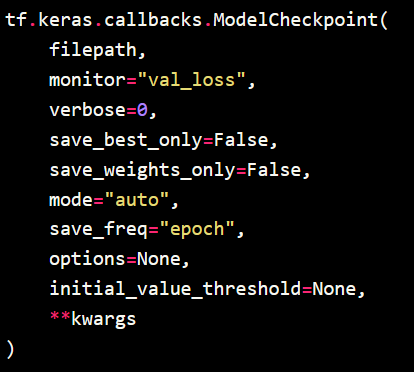

In [ ]:
# Структура данных для callbacks в текущей работе.
callbs = []

# Callback для сохранения модели Keras или весов модели с некоторой периодичностью.
checkpoint = ModelCheckpoint('/content/drive/MyDrive/Diplomnay_rabota/Model/wheat_wg.h5',
                                 
                            # Метрика, которую необходимо отслеживать. 
                            monitor = 'val_loss',

                            # Если save_best_only=True, решение о 
                            # перезаписи текущего файла сохранения 
                            # принимается на основе максимизации или 
                            # минимизации контролируемой величины. 
                            # Для val_acc это должно быть max, для val_loss 
                            # - min и т.д. В автоматическом режиме режим 
                            # устанавливается на max, если контролируемые 
                            # величины имеют значение 'acc' или начинаются с 
                            # 'fmeasure', и устанавливается на min для остальных величин.
                            mode = 'min',
                                 
                            # Сохраняет только тогда, когда модель считается 
                            # "лучшей", и последняя лучшая модель 
                            # в соответствии с отслеживаемым количеством 
                            # не будет перезаписана
                            save_best_only = True,
                                 
                            # Если True, то сохраняются только веса модели 
                            # (model.save_weights(filepath)), иначе сохраняется 
                            # полная модель (model.save(filepath)).
                            save_weights_only = True,

                            # Режим вербальности, 0 или 1. 
                            # В режиме 0 сообщения не выводятся.
                            verbose = 1)
# Добавляем в наш кастомный callback.
callbs.append(checkpoint)

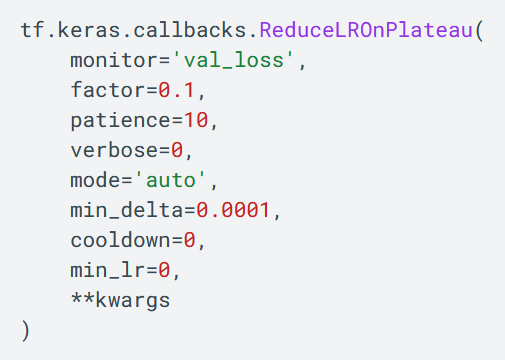

In [ ]:
# ReduceLROnPlateau снижает скорость обучения, когда метрика перестает улучшаться.
reduceLROnPlat = ReduceLROnPlateau(
    
                                    # Метрика, подлежащее контролю. 
                                    monitor = 'val_loss',
                                   
                                    # Коэффициент, на который будет уменьшена 
                                    # скорость обучения. new_lr = lr * коэффициент. 
                                    factor = 0.1,
                                    
                                    # Количество эпох без улучшения, после чего 
                                    # скорость обучения будет снижена
                                    patience = 5,

                                    # int. 0: тишина, 1: обновление сообщений. 
                                    verbose = 1, 
                                   
                                    # одно из {'auto', 'min', 'max'}. В режиме 
                                    # 'min' скорость обучения будет уменьшена, 
                                    # когда контролируемое значение перестанет 
                                    # уменьшаться; в режиме 'max' она будет уменьшена, 
                                    # когда контролируемое значение перестанет увеличиваться;
                                    # в режиме 'auto' направление автоматически 
                                    # определяется по названию контролируемого значения. 
                                    mode = 'auto',
                                   
                                    # Порог для измерения нового оптимума,
                                    # чтобы сосредоточиться только на 
                                    # значительных изменениях.
                                    epsilon = 0.0001, 

                                    # Количество эпох, которое необходимо 
                                    # выждать перед возобновлением нормальной 
                                    # работы после уменьшения lr. 
                                    cooldown = 1, 
                                    
                                    # Нижняя граница скорости обучения. 
                                    min_lr = 0.00001)
# Добавляем в наш кастомный callback.
callbs.append(reduceLROnPlat)

Согласно методу train из официльной реализации, который используется для обучения модели произведём следующий действия:

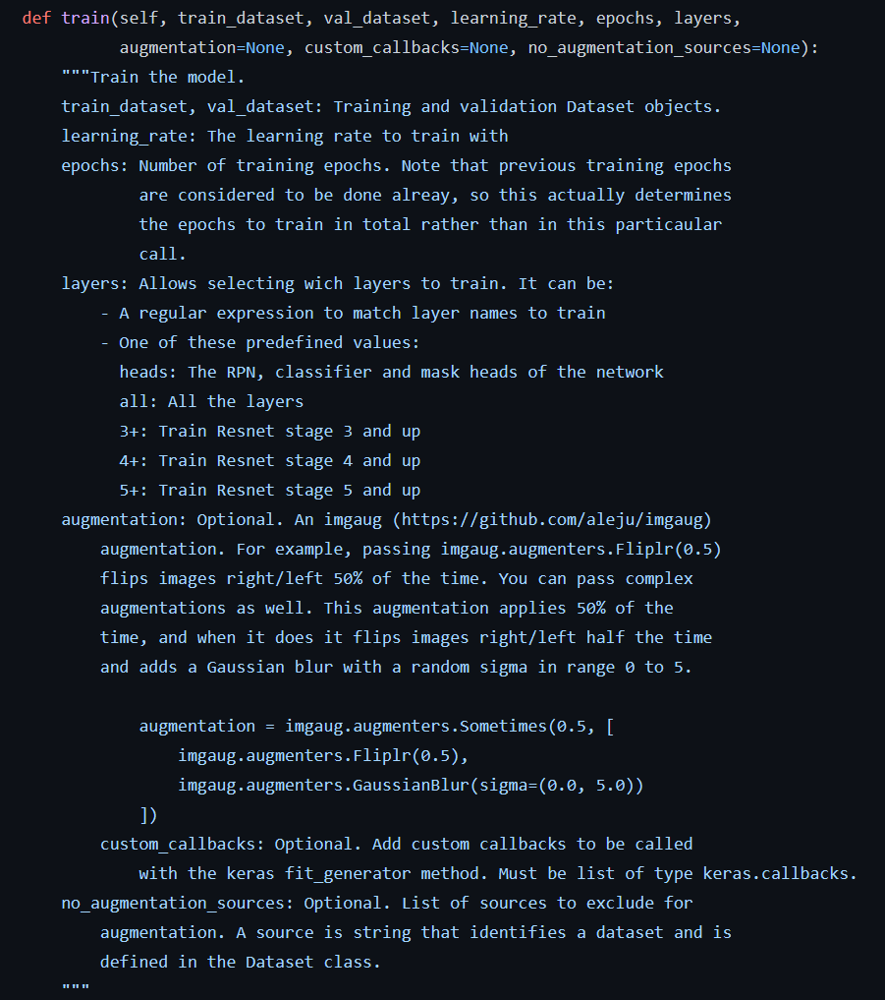

In [ ]:
model_training.train(

                # Датасет для обучения
                dataset_train, 

                # Датасет для валидации
                dataset_valid, 
                
                # Ранее полученные аугментации
                augmentation=augmentation, 
                
                # Learning rate из созданного конфига.
                learning_rate=config.LEARNING_RATE,
                
                # Ранее определённые callbacks
                custom_callbacks = callbs,
                
                # Кол-во эпох. Оптимальное кол-во (см. основной текст)
                epochs = 45, 
                
                # Обучаем все слои (см. документацию).
                layers='all') 

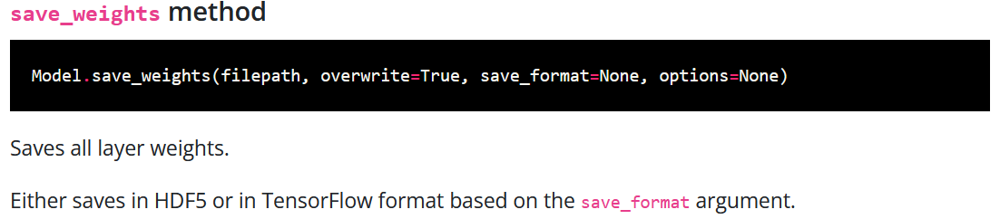

In [ ]:
# Сохраним полученные веса модели для дальнейшего переиспользования
model_training.keras_model.save_weights("my_weights.h5")

С целью визуализации функционала Mask R-CNN Matterport пересоздадим исходную модель в формате inference (вывод результатов), что также предусмотрено в исходных файлах

In [ ]:
# Повторим аналогичные действия с изменением мода и весов.
model_inference = orig_model.MaskRCNN(
    mode='inference',
    config = config, 
    model_dir = '/content/drive/MyDrive/Diplomnay_rabota/Model')

Instructions for updating:
Use tf.cast instead.


In [ ]:
# В качестве используемых весов обратимся к тем, которые получили в режиме training
model_inference.load_weights('/content/drive/MyDrive/Diplomnay_rabota/Model/Final_weights_and_history/my_wheights.h5',
                             by_name=True) 

## Визуализации результатов

In [ ]:
history = pd.read_csv('/content/drive/MyDrive/Diplomnay_rabota/Model/Final_weights_and_history/my_history.csv') 

### Построение графиков метрик

Создадим новую ось для визуализации метрик, согласно следующему методу с определённым размером. 

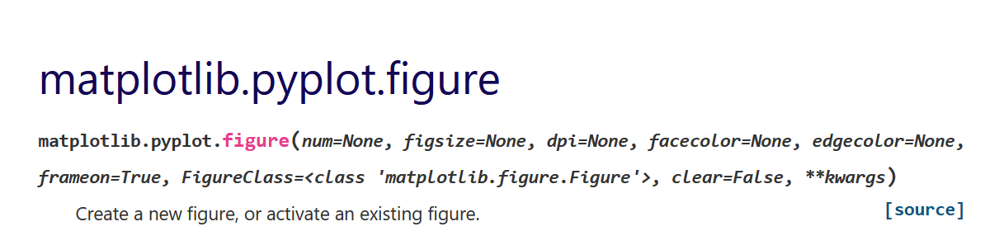

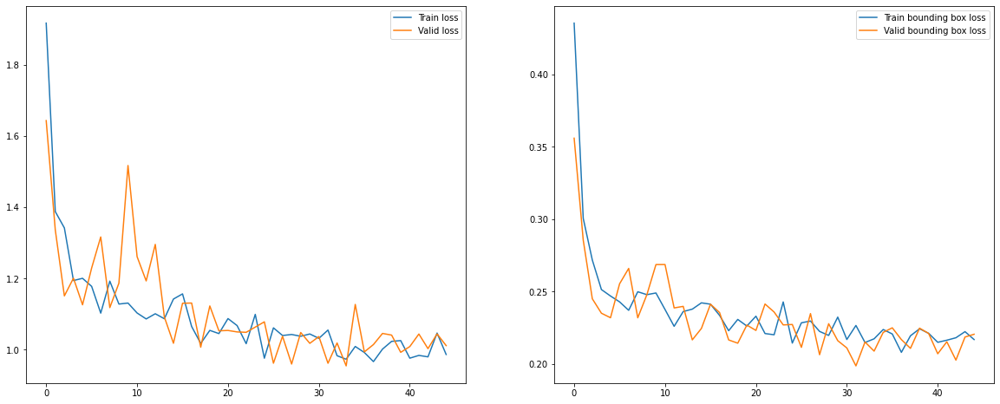

In [ ]:
plt.figure(figsize = (20,8))

# Добавим оси
plt.subplot(1, 2, 1)

# Выведем данные о loss на train датасете
plt.plot(history.epoch, history.loss, label = "Train loss")

# Выведем данные на val датасете
plt.plot(history.epoch, history.val_loss, label = "Valid loss")

# Выведем легенду
plt.legend()

# Повторим действия для bounding boxes
plt.subplot(1, 2, 2)
plt.plot(history.epoch, history.mrcnn_bbox_loss, label = "Train bounding box loss")
plt.plot(history.epoch, history.val_mrcnn_bbox_loss, label = "Valid bounding box loss")
plt.legend()

# Выведем итоговые графики
plt.show()

### Проверим работу модели на изображении из val датасета

Так же с помошью метода из реализации выведем изображения в формате Mask R-CNN
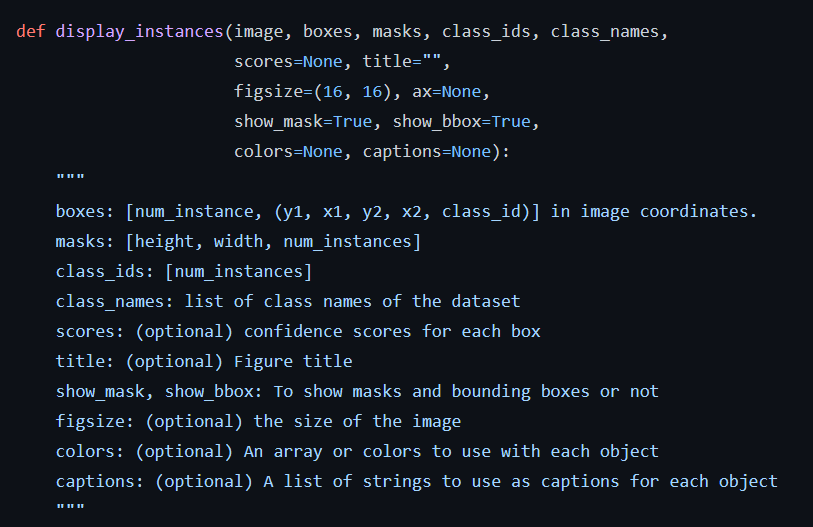

Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int64
anchors                  shape: (1, 261888, 4)        min:   -0.17695  max:    1.11439  float32


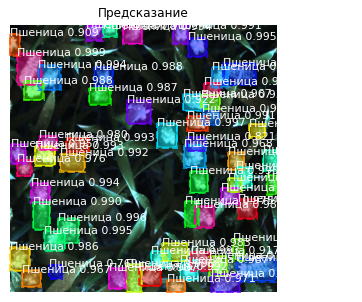

In [ ]:
# Проверим работу модели на 1 случайном изображении из val датасете
# (может быть любое кол-во изобрежений для наглядности)

for img_id in np.random.choice(dataset_valid.image_ids, 1):
    original_image, shape, gt_class_id, gt_bbox, gt_mask =\
        orig_model.load_image_gt(dataset_valid, config,     
                               img_id, use_mini_mask=False)

    # В качестве определяем предсказание, которое получилось в ходе работы
    # model_inference
    results = model_inference.detect([original_image], verbose = 1)

    res = results[0]

    # Согласно ранее расмотренному методу визу
    visualize.display_instances(original_image,

                                # Выводм ROIs (см. теорию в основном тексте диплома) 
                                res['rois'], 

                                # Выводим маску.
                                res['masks'],

                                # Определяем ids.
                                res['class_ids'],

                                # Определяем имена классов. 
                                dataset_valid.class_names,

                                # Выводим показатели предсказания.
                                res['scores'], 

                                # Строим ось.
                                ax=get_ax(), 

                                # Определяем название.
                                title = "Предсказание")


### Вычисление mAP

На основании метода из реализации произведём некоторую модификацию для вычисления mAP на валидационном датасете.
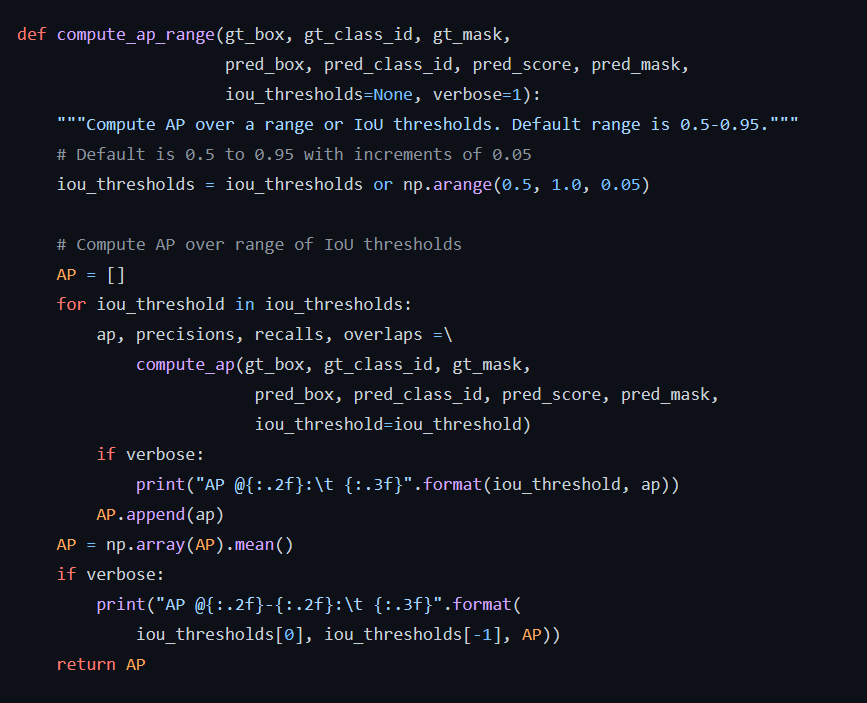

In [ ]:
def get_map(
    # Тестовые данные
    test_set, 
    
    # Ids тестовых данных
    image_ids, 
    
    # Обученная модель
    model, 

    # Пороговые значения IoU
    iou_thresholds, 
    
    # Тестовая конфигурация
    inference_config):
  
    # Структруа данных для хранения данных об average precision
    AP_res = []

    # Установливает, как обрабатываются ошибки с плавающей точкой.
    # np.seterr(divide = 'ignore', invalid = 'ignore') 
    
    # По всем ids изображений
    for image_id in image_ids:

        # Загружаем истинные данные для изображения на основе метода,
        # который рассматриваои ранее.
        image, shape, gt_class_id, gt_bbox, gt_mask =\
            orig_model.load_image_gt(test_set, inference_config,
                                   image_id, use_mini_mask=False)

        # Производим детекцию модели
        results = model_inference.detect([image], verbose=0)

        r = results[0]

        # Вычисляем ap_range согласно методу выше
        AP_range = utils.compute_ap_range(gt_bbox, gt_class_id, gt_mask, 
                                          r["rois"], r["class_ids"], r["scores"], r['masks'],
                                          iou_thresholds = iou_thresholds, verbose = 0)
        
        # Проверяем, является ли AP_range значением NaN или нет:
        if math.isnan(AP_range):
            continue
            
        #  Добавляем полученное значение
        AP_res.append(AP_range)   
        
    return AP_res

In [ ]:
# Вычисляем значение AP
# Данные thresh_score можно менять для получения результатов в различных 
# промежутках
AP_res = get_map(dataset_valid, dataset_valid.image_ids,
                              model_inference, 
                              [0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.75], config)

Выведем значение mAP

In [ ]:
print("mAP: ", np.mean(AP_res))

### Апробация модели на тестовых данных

Составим метод для работы с изображения из тестовых данных на основе данных рекомендаций (https://stackoverflow.com/questions/4568580/python-glob-multiple-filetypes)

In [ ]:
def get_picture(img_dir):

    # Определяем список ряда тестовых данных.
    picture_snaps = glob.glob(img_dir + '*.jpg')
    return list(set(picture_snaps))

In [ ]:
# Загрузим ряд тестовых данных

test_img_root  = '/content/drive/MyDrive/Diplomnay_rabota/GWHD/test/'
test_image_snaps = get_picture(test_img_root)

Некоторые наработки были взяты из соревнования по детекции пневномонии на Kaggle (https://www.kaggle.com/code/pratyush1019/fork-of-rsna-kaggle-problem-pneumonia-mask-r-cnn/notebook).

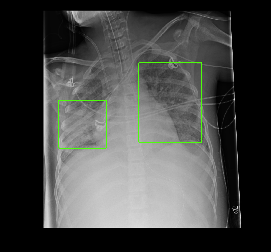

К примеру, 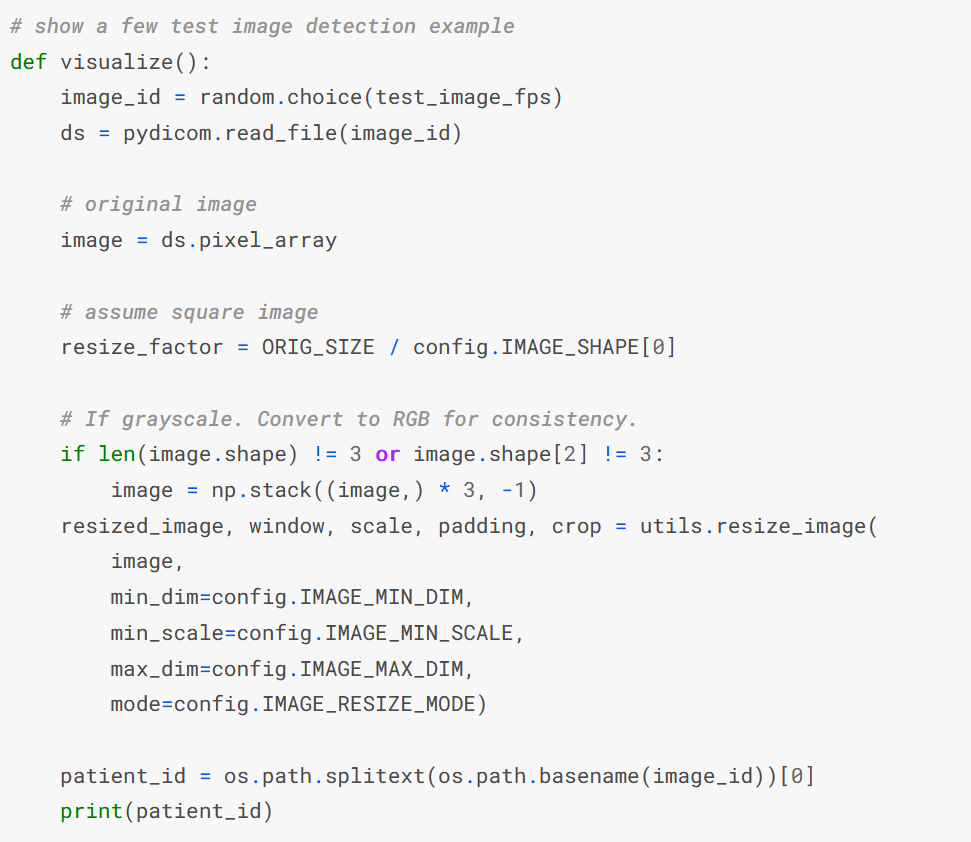

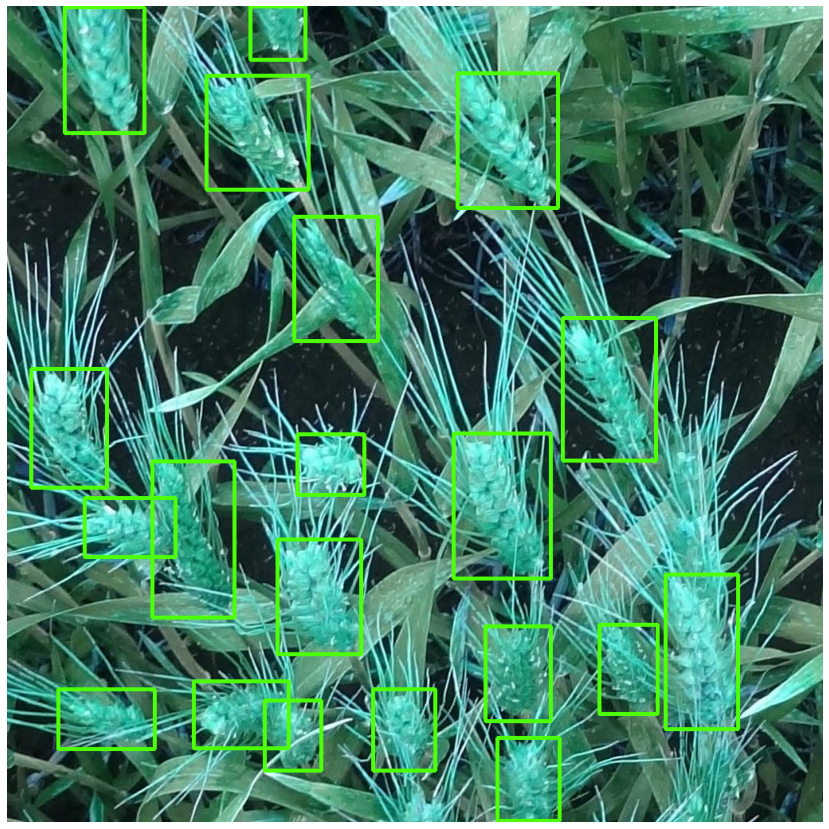

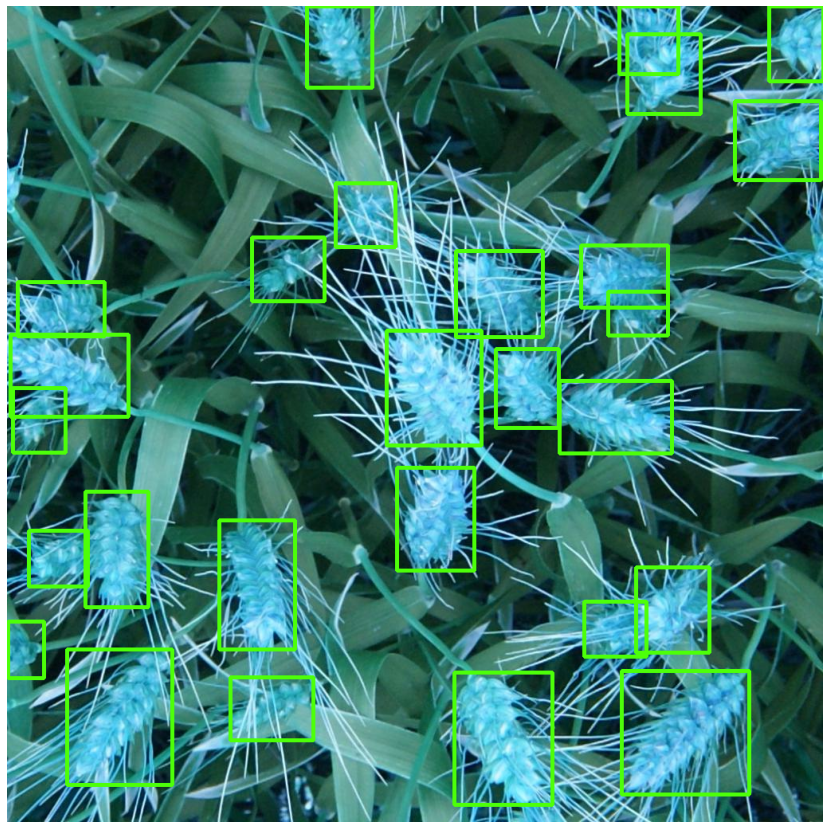

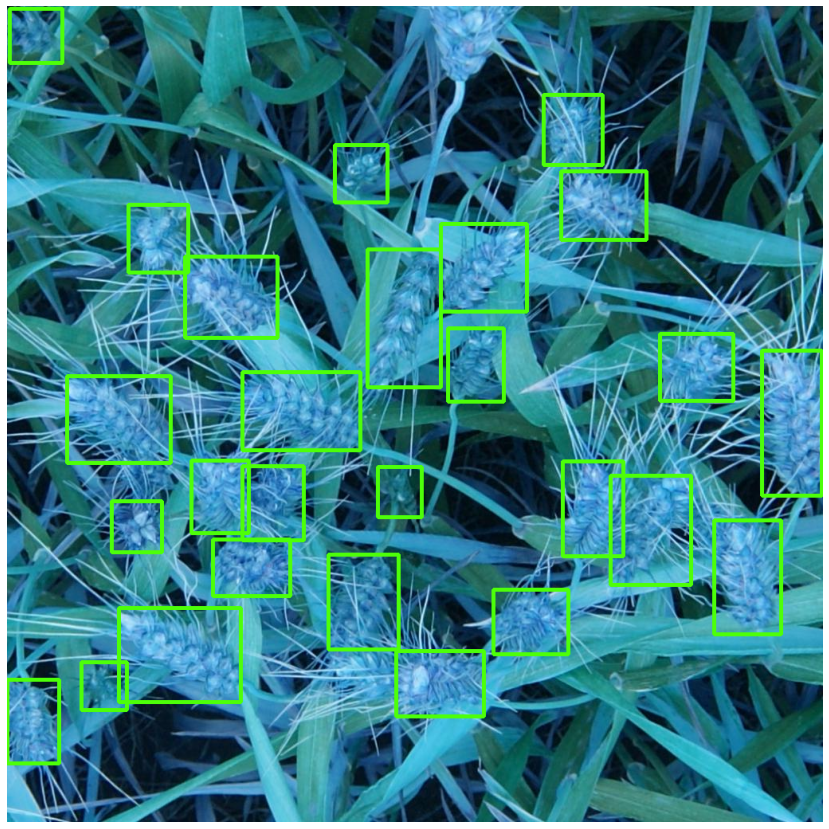

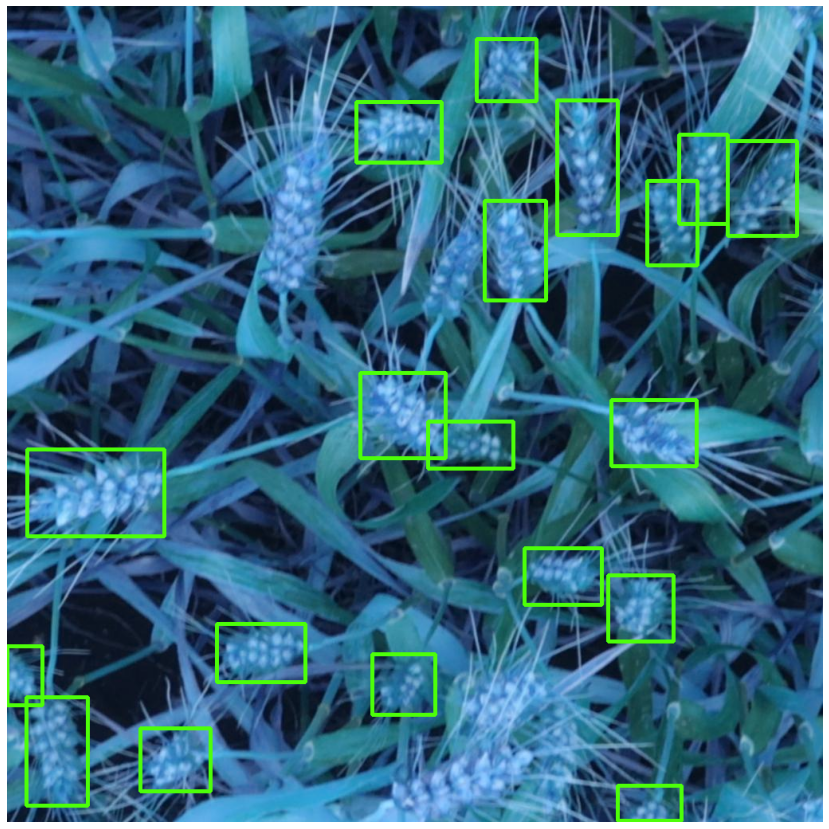

...

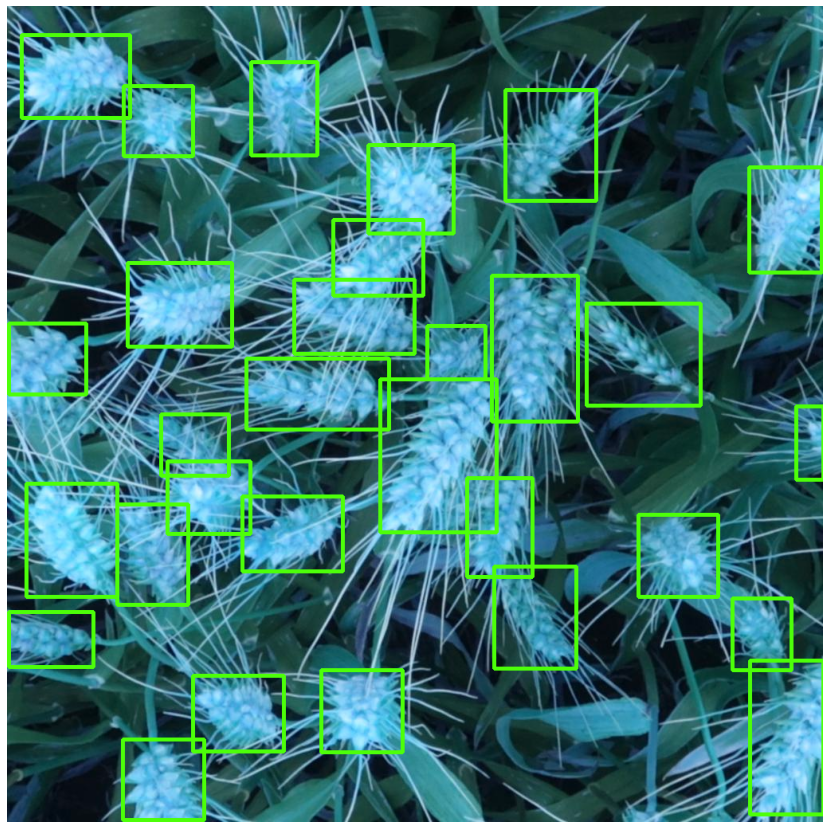

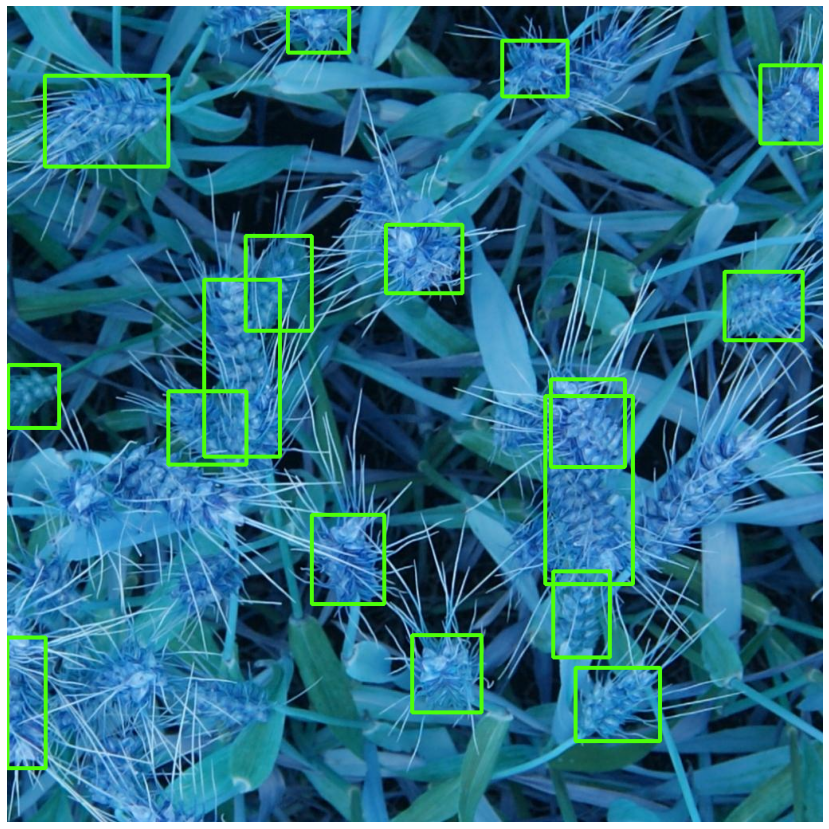

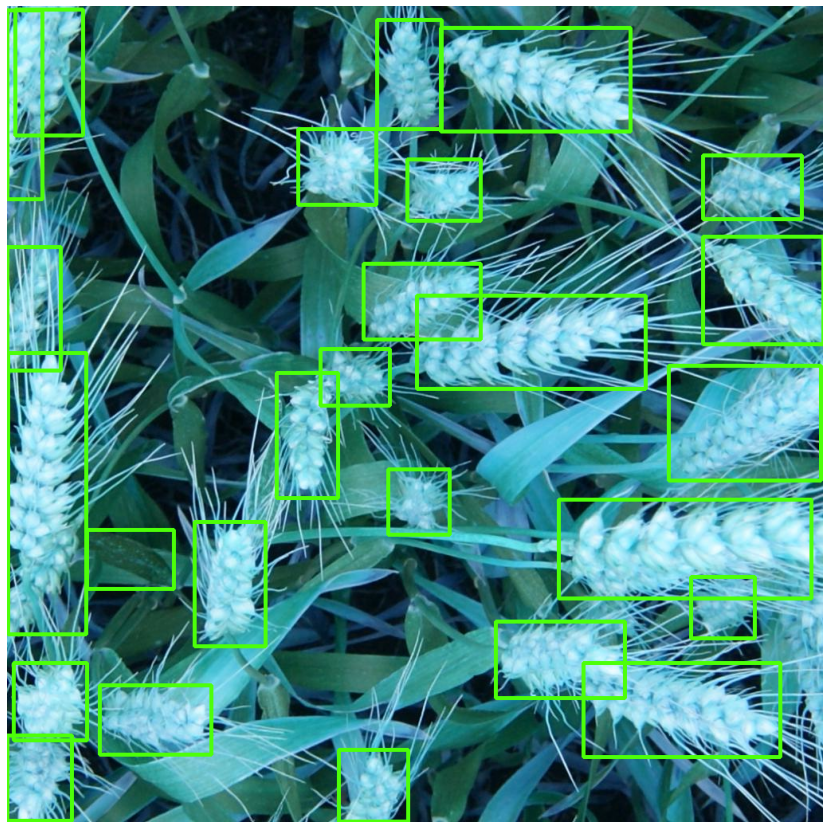

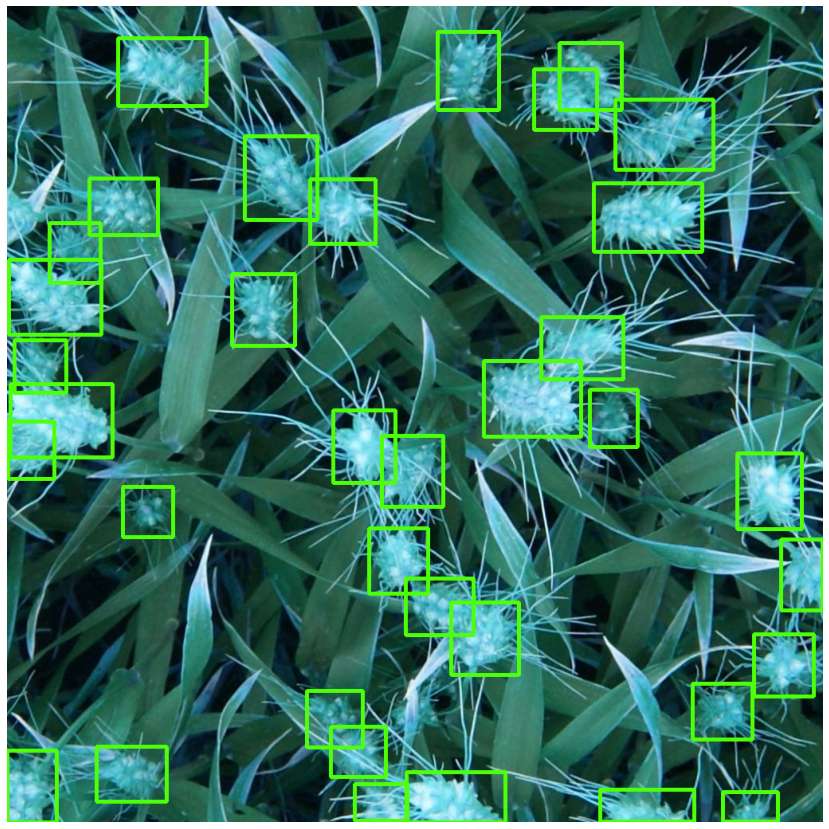

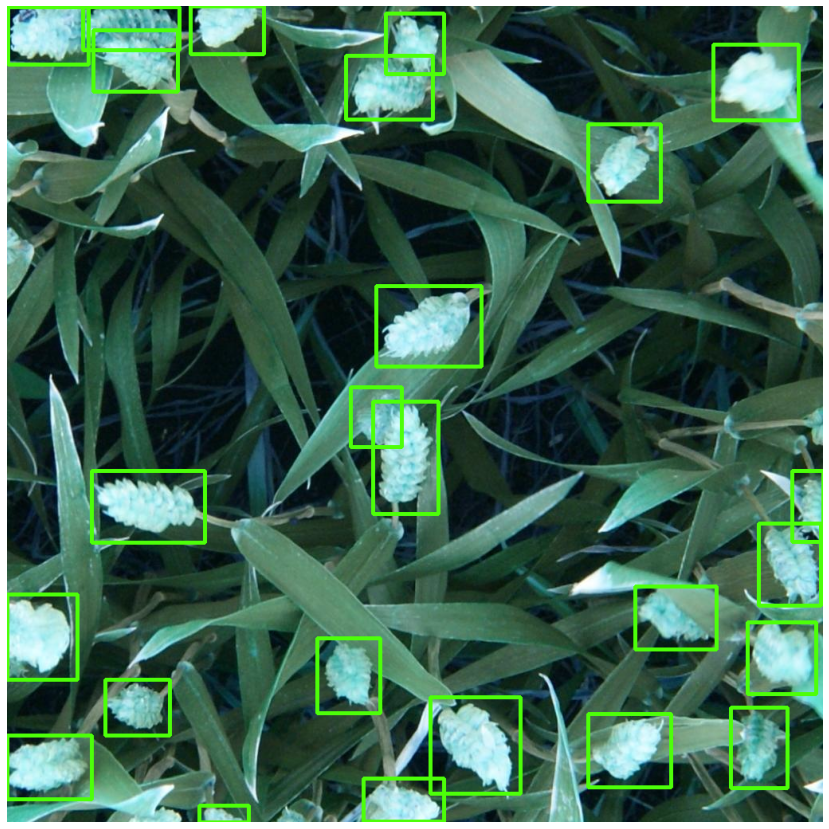

In [ ]:
# По тестовым изображениями
for image_id in test_image_snaps:

    # Метод cv2.imread() загружает изображение из указанного файла. 
    # Если изображение не может быть прочитано (из-за отсутствия файла, 
    # неправильных прав доступа, неподдерживаемого или недопустимого формата), 
    # то этот метод возвращает пустую матрицу.
    image = cv2.imread(image_id, 
                       
                       # Определяет загрузку цветного изображения.
                       # Любая прозрачность изображения будет проигнорирована. 
                       # Это флаг по умолчанию. В качестве альтернативы можно 
                       # передать целочисленное значение 1 для этого флага.
                       cv2.IMREAD_COLOR)

    # Согласно методу выше.
    # (https://www.kaggle.com/code/pratyush1019/fork-of-rsna-kaggle-problem-pneumonia-mask-r-cnn/notebook)
    resize_factor = 1024 / config.IMAGE_SHAPE[0]

    if len(image.shape) != 3 or image.shape[2] != 3:
        image = np.stack((image,) * 3, -1) 

    # Используем метод из utils для изменения размера изображения.
    resized_image, window, scale, padding, crop = utils.resize_image(
        image,
        min_dim = config.IMAGE_MIN_DIM,
        min_scale = config.IMAGE_MIN_SCALE,
        max_dim = config.IMAGE_MAX_DIM,
        mode = config.IMAGE_RESIZE_MODE)

    # Определяем id изображения
    # Наработки взяты из этого источника (https://towardsdatascience.com/skin-cancer-classification-with-machine-learning-c9d3445b2163)
    image_id = os.path.splitext(os.path.basename(image_id))[0]

    # Произведём детекцию тестовых данных с помощью модели
    results = model_inference.detect([resized_image])
    r = results[0]
    

    # Наработки были взяты из этого файла по детекции пневмонии 
    # (https://www.kaggle.com/code/lextoumbourou/coco-mask-rcnn-with-submission-stage-2/notebook)
    # (https://stackoverflow.com/questions/23720875/how-to-draw-a-rectangle-around-a-region-of-interest-in-python)
    for bbox in r['rois']: 
        x1 = int(bbox[1] * resize_factor)
        y1 = int(bbox[0] * resize_factor)
        x2 = int(bbox[3] * resize_factor)
        y2 = int(bbox[2] * resize_factor)
        cv2.rectangle(image, (x1,y1), (x2,y2), (77, 255, 9), 3, 1)
        width  = x2 - x1 
        height = y2 - y1 

    plt.figure(figsize=(15, 15)) 

    # Без решётки
    plt.grid(False)

    # Без осей
    plt.axis('off')

    # Выведем изображения с предсказаниями
    plt.imshow(image)
    # plt.savefig(f"{image_id}.png", bbox_inches='tight', dpi=500)